# Fix spikes in the wind and altitude data

Author: Brian Green (briangre@stanford.edu

In [1]:
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
from notebook_utils import before_and_after_segments
from tqdm.notebook import tqdm
pd.options.mode.chained_assignment = None  # default='warn'
from scipy import interpolate

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    tqdm.pandas()

%matplotlib inline

DELTA_ALT_THRESH = 100 # (m); the change in altitude from one time step to another big enough to be called a spike

### Load the data from the previous step

In [2]:
flights = pd.read_feather('3b_segments_cosmic.feather')
flights = flights.rename(columns={'velocity_u': 'wind_u'})
flights = flights.rename(columns={'velocity_v': 'wind_v'})

# drop time steps with NaN altitude data
flights = flights.drop(flights.loc[pd.isna(flights.altitude) == 1].index)
flights = flights.reset_index(drop=True)

flights

,flight_id,time,latitude,longitude,altitude,pressure,wind_u,wind_v,T_cosmic,dTdz_cosmic,N_cosmic,suspicious_motion,segment_id
0,F-011,2012-10-10 22:43:48.200,37.488174,-120.358887,21725.0,42.70,5.427,0.109,-60.406238,0.001952,47.0,0,9
1,F-011,2012-10-10 22:46:48.200,37.488205,-120.348259,21723.0,42.83,5.317,-0.068,-60.410142,0.001951,47.0,0,9
2,F-011,2012-10-10 22:49:48.210,37.487953,-120.337318,21720.0,42.76,5.132,-0.132,-60.415993,0.001949,47.0,0,9
3,F-011,2012-10-10 22:52:48.210,37.487778,-120.327438,21728.0,42.71,4.914,0.075,-60.400377,0.001954,47.0,0,9
4,F-011,2012-10-10 22:55:48.210,37.488194,-120.317383,21733.0,42.70,4.717,0.280,-60.390596,0.001957,47.0,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...
43092168,LN-325,2021-03-06 11:37:20.000,11.197386,-135.131277,17415.5,84.49,-2.421,4.332,-78.845204,0.000700,282.0,0,270216
43092169,LN-325,2021-03-06 11:38:20.000,11.199723,-135.132479,17411.7,84.52,-2.446,4.314,-78.845070,0.000672,281.0,0,270216
43092170,LN-325,2021-03-06 11:38:33.000,11.200217,-135.132738,17413.3,84.51,-2.472,4.336,-78.844004,0.000675,281.0,0,270216
43092171,LN-325,2021-03-06 11:39:20.000,11.202002,-135.133763,17420.1,84.42,-2.513,4.351,-78.839396,0.000688,281.0,0,270216


### Fix single-point wind jumps
For wind values that increase (decrease) more than 1/30 m/s^2 = (2 m/s) / (60 s) from their previous value and decrease (increase) more than 1/30 m/s^2 to the next value, replace with the previous value.

(Previously, the threshold was a +/- 2 m/s jump, but that would trigger unphysical changes to wind values across data gaps.)

In [10]:
def replace_wind_jumps(segment):
    
    # Calculate the time step, in seconds
    segment['dt'] = segment.time.diff()/pd.Timedelta(1,'seconds')
    
    # Shift the values one time step so the second diff operates on the time step after a given value
    segment_shifted = segment.shift(periods=-1, axis="rows")
    
    # An increase from the previous value, then a decrease to the next value
    u_change1 = segment.loc[(segment.wind_u.diff()/segment.dt > (1/30)) & 
                            (segment_shifted.wind_u.diff()/segment_shifted.dt < -(1/30))]
    v_change1 = segment.loc[(segment.wind_v.diff()/segment.dt > (1/30)) & 
                            (segment_shifted.wind_v.diff()/segment_shifted.dt < -(1/30))]
    
    # A decrease from the previous value, then an increase to the next value
    u_change2 = segment.loc[(segment.wind_u.diff()/segment.dt < -(1/30)) & 
                            (segment_shifted.wind_u.diff()/segment_shifted.dt > (1/30))]
    v_change2 = segment.loc[(segment.wind_v.diff()/segment.dt < -(1/30)) & 
                            (segment_shifted.wind_v.diff()/segment_shifted.dt > (1/30))]
    
    # Set the flagged data to their value at the previous time step
    temp = segment.shift(periods=1, axis="rows")
    segment.loc[u_change1.index,['wind_u']] = temp.loc[u_change1.index,['wind_u']]
    segment.loc[v_change1.index,['wind_v']] = temp.loc[v_change1.index,['wind_v']]
    segment.loc[u_change2.index,['wind_u']] = temp.loc[u_change2.index,['wind_u']]
    segment.loc[v_change2.index,['wind_v']] = temp.loc[v_change2.index,['wind_v']]
    
    return segment

temp = flights.reset_index(drop=True)
flights = flights.groupby('segment_id').progress_apply(replace_wind_jumps).reset_index(drop=True)

#before_and_after_segments(temp, flights, 20, 'wind_u', 'wind_u')
#del temp

  0%|          | 0/124073 [00:00<?, ?it/s]

### Fix single-point altitude spikes

An altitude spike is defined as one data point that is more than DELTA_ALT_THRESH in altitude away from its neighbors; the altitude changes on either side of the point must have opposite signs

In [3]:
def single_altitude_spike(segment):
    
    # Shift the values one time step so the second diff operates on the time step after a given value
    segment_shifted = segment.shift(periods=-1, axis="rows")
    # An increase from the previous value, then a decrease to the next value
    alt_change1 = segment.loc[(segment.altitude.diff() > DELTA_ALT_THRESH) & 
                              (segment_shifted.altitude.diff() < -DELTA_ALT_THRESH)]
    # A decrease from the previous value, then an increase to the next value
    alt_change2 = segment.loc[(segment.altitude.diff() < -DELTA_ALT_THRESH) & 
                              (segment_shifted.altitude.diff() > DELTA_ALT_THRESH)]
    # Set the flagged data to their value at the previous time step
    temp = segment.shift(periods=1, axis="rows")
    segment.loc[alt_change1.index,['altitude']] = temp.loc[alt_change1.index,['altitude']]
    segment.loc[alt_change2.index,['altitude']] = temp.loc[alt_change2.index,['altitude']]
    
    return segment

temp = flights.reset_index(drop=True)
flights = flights.groupby('segment_id').progress_apply(single_altitude_spike).reset_index(drop=True)

#before_and_after_segments(temp, flights, 20, 'altitude', 'altitude')
#del temp

  0%|          | 0/124073 [00:00<?, ?it/s]

In [5]:
flights.to_feather('4_flights_nativetime_intermediate_singlespikes.feather')

In [3]:
flights = pd.read_feather('4_flights_nativetime_intermediate_singlespikes.feather')

### Fix multiple-point wind spikes, and single spikes missed in the previous step, in segments longer than two days.

This is done by hand; several attempts at writing an algorithm to do this were unsuccessful

In [4]:
# Find segments longer than two days
min_length = pd.Timedelta('2 days')
segments_to_select = flights.groupby('segment_id').apply(lambda f: f.time.iloc[-1] - f.time.iloc[0])
segments_to_select = segments_to_select[segments_to_select > min_length]
flights_2days = flights[flights.segment_id.isin(segments_to_select.index)]

# Find segments with wind jumps greater than 2 m/s
flights_2days['diff_u'] = flights_2days.wind_u.diff().abs()
flights_2days['diff_v'] = flights_2days.wind_v.diff().abs()
diff_segs = flights_2days.copy()
diff_segs_u = diff_segs.groupby('segment_id').apply(lambda f: f.diff_u.iloc[1:].max())
diff_segs_v = diff_segs.groupby('segment_id').apply(lambda f: f.diff_v.iloc[1:].max())
diff_segs_u = diff_segs_u[diff_segs_u > 2]
diff_segs_v = diff_segs_v[diff_segs_v > 2]

print('Number of u segments:', diff_segs_u.index.nunique())
print('Number of v segments:', diff_segs_v.index.nunique())

Number of u segments: 117
Number of v segments: 105


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_18377/4037898278.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


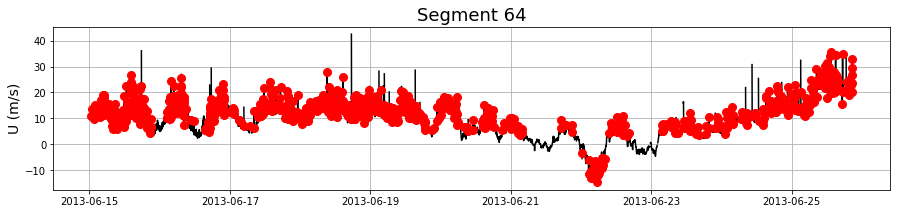

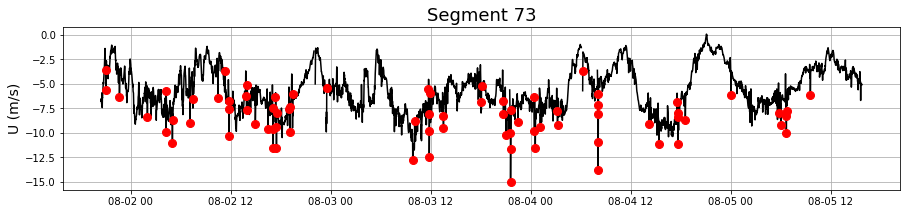

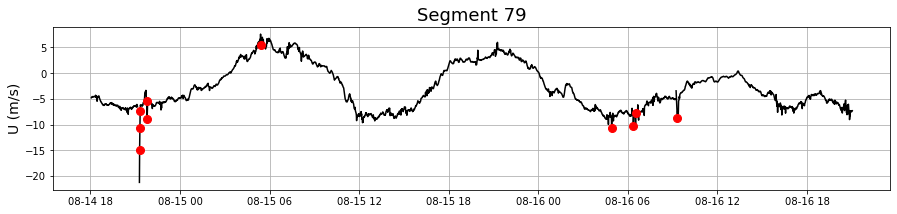

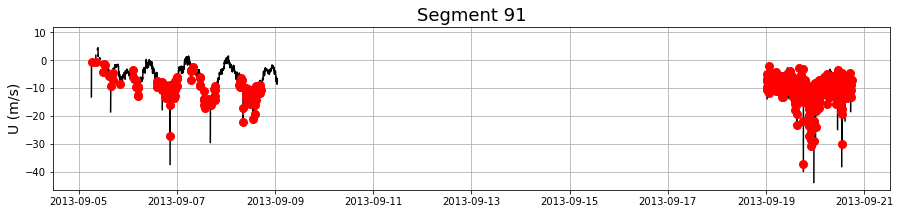

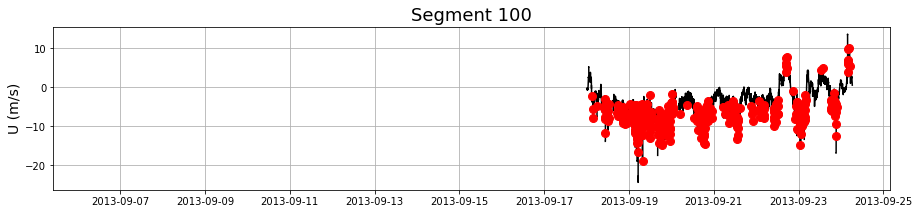

...

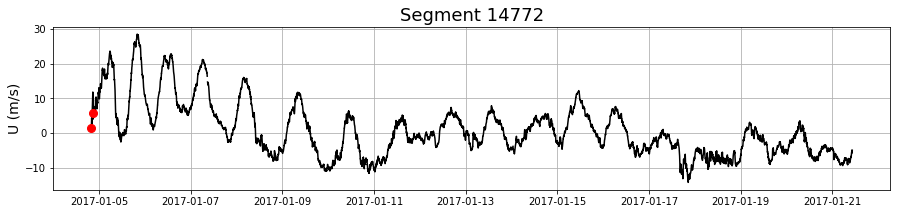

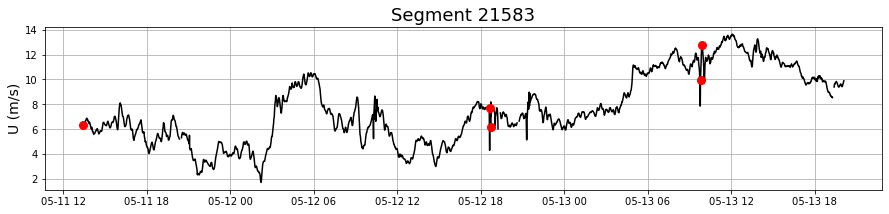

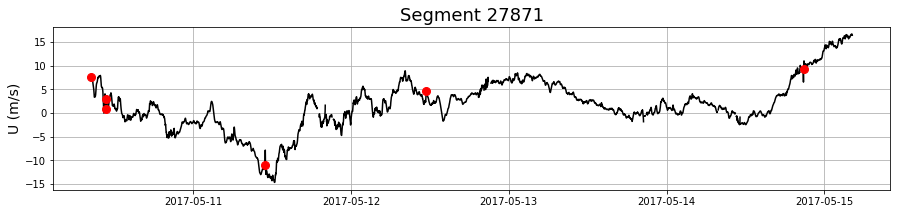

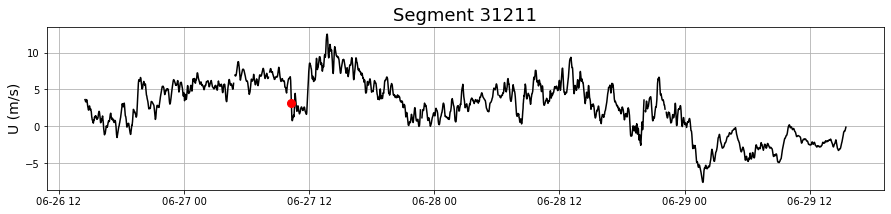

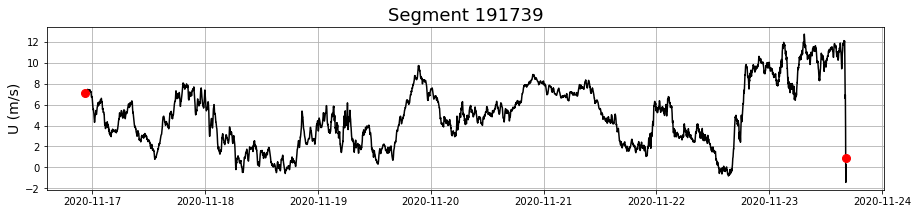

In [5]:
# Plot the zonal wind segments
segment_ids = np.array(diff_segs_u.index.unique())
n_segments = diff_segs_u.index.nunique()

# Plot all of these segments, highlighting the altitude jumps
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    temp = segment[segment.diff_u > 2]
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.wind_u,'k')
    plt.plot(temp.time,temp.wind_u,'ro',markersize=8)
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('U (m/s)', fontsize=14);

/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_18377/3780014560.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


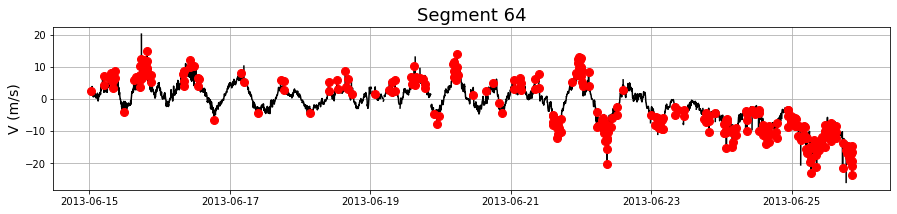

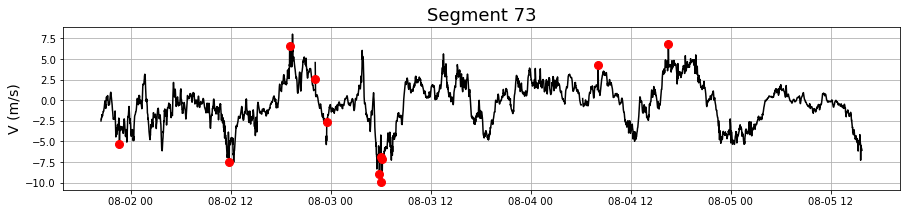

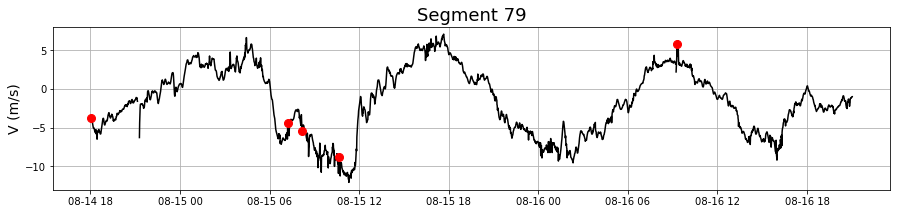

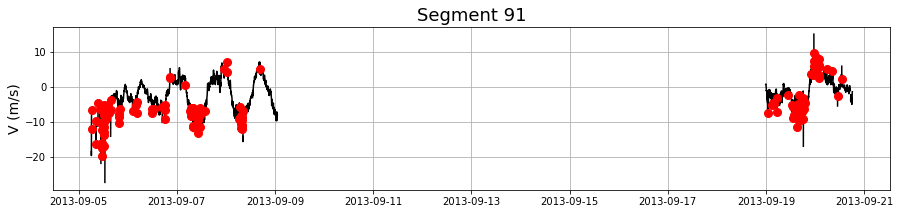

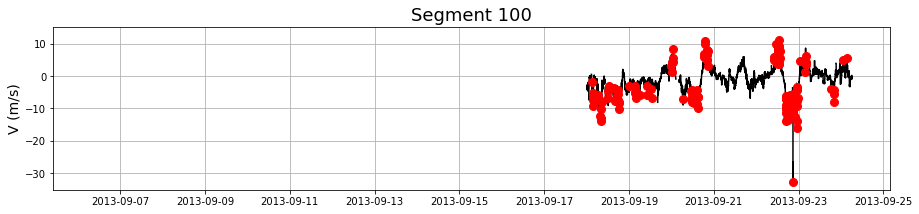

...

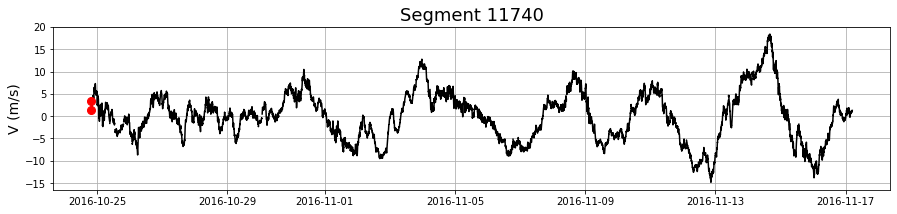

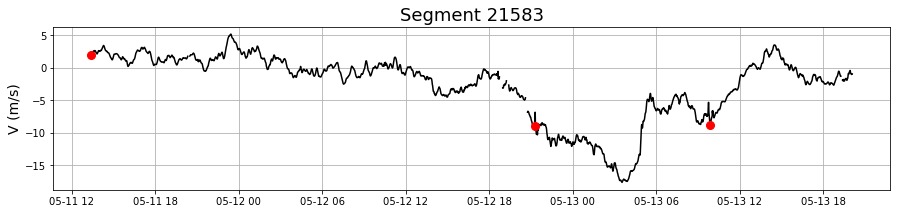

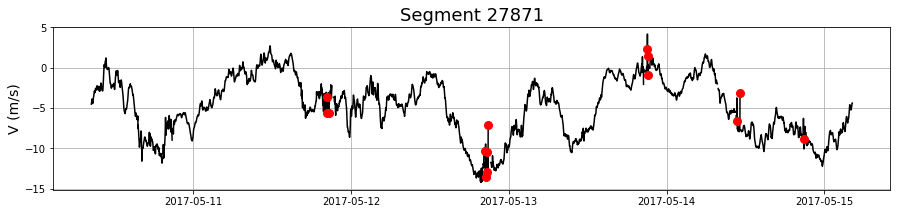

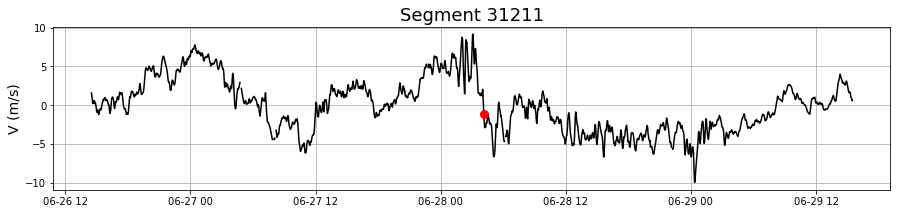

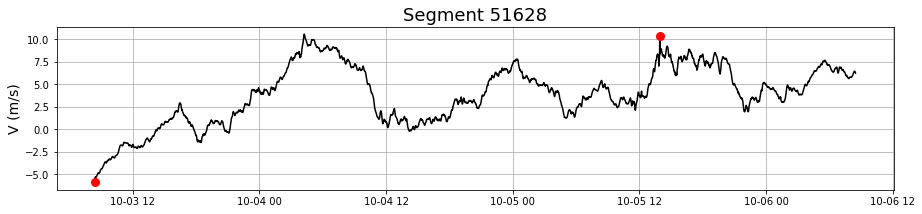

In [6]:
# Plot the meridional wind segments
segment_ids = np.array(diff_segs_v.index.unique())
n_segments = diff_segs_v.index.nunique()

# Plot all of these segments, highlighting the altitude jumps
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    temp = segment[segment.diff_v > 2]
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.wind_v,'k')
    plt.plot(temp.time,temp.wind_v,'ro',markersize=8)
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('V (m/s)', fontsize=14);

### Investigate wind spikes visually identified above by zooming in on them

If a spike is found, note its location in the dataset

nan nan 2013


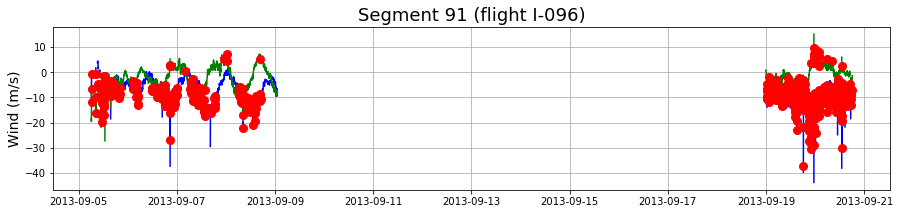

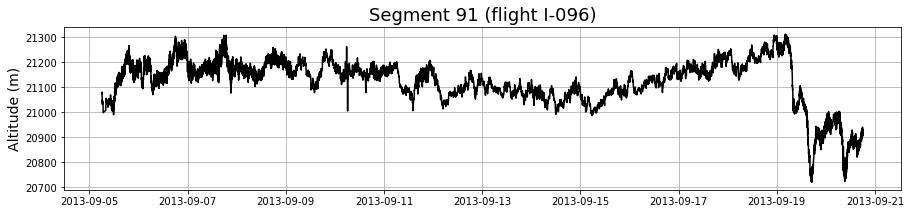

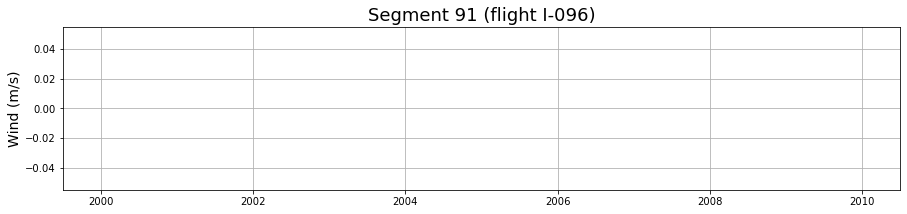

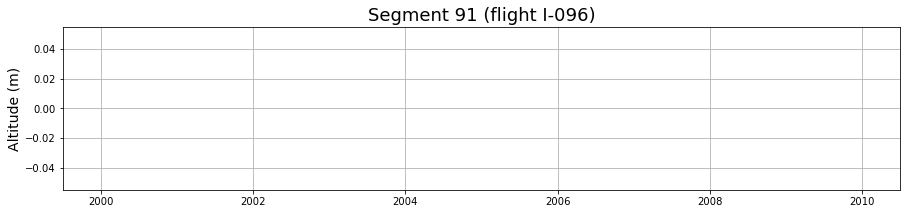

In [97]:
# Lists of segments with possible spikes
spikes = np.array([79,230,443,1502,1787,1853,5491,7451,21583,27871])

# Look at one segment
segment_id = 91
segment = flights[flights.segment_id == segment_id].copy()
segment['diff_u'] = segment.wind_u.diff().abs()
segment['diff_v'] = segment.wind_v.diff().abs()
temp_u = segment[segment.diff_u > 2]
temp_v = segment[segment.diff_v > 2]

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.wind_u,'b')
plt.plot(segment.time,segment.wind_v,'g')
plt.plot(temp_u.time,temp_u.wind_u,'ro',markersize=8)
plt.plot(temp_v.time,temp_v.wind_v,'ro',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Wind (m/s)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.altitude,'k')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

# Zoom in on the spike, marking its location to be referenced later
time_start = np.datetime64('2017-05-12 21:00')
time_stop =  np.datetime64('2017-05-12 22:00')

plt.figure(figsize=(15,3))
temp = segment[segment.time >= time_start]
temp = temp[temp.time < time_stop]
plt.plot(temp.time,temp.wind_u,'-bx')
plt.plot(temp.time,temp.wind_v,'-gx')
plt.plot(temp.loc[14087619:14087629,'time'],temp.loc[14087619:14087629,'wind_u'],'mo',markersize=8)
plt.plot(temp.loc[14087619:14087629,'time'],temp.loc[14087619:14087629,'wind_v'],'mo',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Wind (m/s)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(temp.time,temp.altitude,'-kx')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

print(temp.index.min(), temp.index.max(), segment.time.dt.year.iloc[0])

### Print the flight_ids and times of the wind spikes, so they can be labeled and removed

By noting the flight_ids and times, fixing the spikes no longer depends on the segment_id or the index, both of which can change.

In [16]:
## DO NOT RE-RUN THIS SECTION OF CODE; THE INDICES MIGHT HAVE CHANGED (SEE COMMENTED OUTPUT BELOW)

# Segment 79 (Flight I-089)
print(flights.loc[31711:31715,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[33610:33611,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[33697:33698,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[33869:33878,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 230 (Flight I-152)
print(flights.loc[436740,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 443 (Flight I-195)
print(flights.loc[828559:828563,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 1502 (Flight I-249)
print(flights.loc[2586602:2586607,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 1787 (Flight I-255)
print(flights.loc[2970313:2970318,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 1853 (Flight I-256)
print(flights.loc[3097129:3097133,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 5491 (Flight I-343)
print(flights.loc[8422314:8422316,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 7451 (Flight I-444)
print(flights.loc[10224971:10224977,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 21583 (Flight O-252)
print(flights.loc[14087488:14087494,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[14087619:14087629,['flight_id','time','wind_u','wind_v']])
print('')

# Segment 27871 (Flight OL-046)
print(flights.loc[15608398,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[15609801:15609806,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[15611694,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[15613077:15613081,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[15613866:15613874,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[15613886:15613891,['flight_id','time','wind_u','wind_v']])
print('')
print(flights.loc[15614454:15614459,['flight_id','time','wind_u','wind_v']])
print('')

## OUTPUT FROM THE ABOVE SECTION OF CODE:
#      flight_id                time  wind_u  wind_v
#31711     I-089 2013-08-14 21:16:42 -21.244  -6.285
#31712     I-089 2013-08-14 21:17:24 -14.878  -4.434
#31713     I-089 2013-08-14 21:17:38 -14.313  -4.383
#31714     I-089 2013-08-14 21:18:38 -10.645  -3.334
#31715     I-089 2013-08-14 21:19:38  -7.419  -2.421

#      flight_id                time  wind_u  wind_v
#33610     I-089 2013-08-16 04:54:38 -10.600   -4.37
#33611     I-089 2013-08-16 04:55:33  -9.247   -3.73

#      flight_id                time  wind_u  wind_v
#33697     I-089 2013-08-16 06:21:39 -10.323  -1.492
#33698     I-089 2013-08-16 06:22:40  -9.315  -1.076

#      flight_id                time  wind_u  wind_v
#33869     I-089 2013-08-16 09:13:37  -3.439   2.200
#33870     I-089 2013-08-16 09:18:35  -8.801   5.811
#33871     I-089 2013-08-16 09:19:34  -8.801   4.242
#33872     I-089 2013-08-16 09:20:04  -7.400   5.006
#33873     I-089 2013-08-16 09:20:15  -8.500   5.739
#33874     I-089 2013-08-16 09:20:28  -9.283   6.234
#33875     I-089 2013-08-16 09:20:41  -9.367   6.213
#33876     I-089 2013-08-16 09:20:55  -8.971   5.914
#33877     I-089 2013-08-16 09:22:25  -7.998   5.238
#33878     I-089 2013-08-16 09:23:15  -6.702   4.298

#flight_id                         I-152
#time         2014-05-01 15:32:20.813000
#wind_u                           12.048
#wind_v                            1.236
#Name: 436736, dtype: object

#       flight_id                time  wind_u  wind_v
#828559     I-195 2014-07-02 20:08:19  16.502   4.596
#828560     I-195 2014-07-02 20:09:19  16.502   3.925
#828561     I-195 2014-07-02 20:10:19  19.296   5.375
#828562     I-195 2014-07-02 20:11:19  19.212   5.114
#828563     I-195 2014-07-02 20:15:19  21.427   5.797

#        flight_id                time  wind_u  wind_v
#2586602     I-249 2014-07-30 11:57:30  30.926   3.480
#2586603     I-249 2014-07-30 11:58:30  30.926   3.172
#2586604     I-249 2014-07-30 11:59:30  35.530   4.328
#2586605     I-249 2014-07-30 12:00:30  35.402   4.509
#2586606     I-249 2014-07-30 12:03:30  40.481   4.781
#2586607     I-249 2014-07-30 12:04:30  38.937   4.236

#        flight_id                time  wind_u  wind_v
#2970313     I-255 2014-08-07 08:33:37  41.513  14.424
#2970314     I-255 2014-08-07 08:34:37  41.513  14.424
#2970315     I-255 2014-08-07 08:35:37  48.609  16.380
#2970316     I-255 2014-08-07 08:36:37  48.531  16.162
#2970317     I-255 2014-08-07 08:39:37  48.531  18.364
#2970318     I-255 2014-08-07 08:40:37  53.206  17.602

#        flight_id                time  wind_u  wind_v
#3097129     I-256 2014-09-21 05:31:44  45.377  10.977
#3097130     I-256 2014-09-21 05:32:44  45.377  10.977
#3097131     I-256 2014-09-21 05:33:44  53.048  11.916
#3097132     I-256 2014-09-21 05:34:44  52.657  11.707
#3097133     I-256 2014-09-21 05:38:44  60.101  12.089

#        flight_id                    time  wind_u  wind_v
#8422314     I-343 2014-08-25 13:40:14.121  -3.878  -1.824
#8422315     I-343 2014-08-25 13:41:14.121  -1.789  -1.093
#8422316     I-343 2014-08-25 13:42:14.121  -1.112  -0.877

#         flight_id                    time  wind_u  wind_v
#10224971     I-444 2015-01-19 15:05:42.210  15.618  25.088
#10224972     I-444 2015-01-19 15:06:42.210  15.333  24.620
#10224973     I-444 2015-01-19 15:07:43.210     NaN     NaN
#10224974     I-444 2015-01-19 15:11:41.851 -10.136 -17.107
#10224975     I-444 2015-01-19 15:12:41.851     NaN     NaN
#10224976     I-444 2015-01-19 15:13:41.851  -0.683  -1.818
#10224977     I-444 2015-01-19 15:15:09.851   4.347   6.219

#         flight_id                time  wind_u  wind_v
#14087488     O-252 2017-05-12 18:36:41   5.823  -0.794
#14087489     O-252 2017-05-12 18:37:41   4.286  -0.570
#14087490     O-252 2017-05-12 18:38:41   7.682  -1.716
#14087491     O-252 2017-05-12 18:39:42   7.610  -1.615
#14087492     O-252 2017-05-12 18:41:42   6.999  -1.712
#14087493     O-252 2017-05-12 18:42:41   8.185  -1.744
#14087494     O-252 2017-05-12 18:43:42   6.167  -1.412

#         flight_id                time  wind_u  wind_v
#14087619     O-252 2017-05-12 21:16:01   6.071  -8.021
#14087620     O-252 2017-05-12 21:17:01   5.136  -6.879
#14087621     O-252 2017-05-12 21:18:01   5.136  -6.879
#14087622     O-252 2017-05-12 21:19:02   6.689  -8.944
#14087623     O-252 2017-05-12 21:23:02   8.175 -10.262
#14087624     O-252 2017-05-12 21:26:03   7.606  -8.919
#14087625     O-252 2017-05-12 21:27:03   8.874 -10.348
#14087626     O-252 2017-05-12 21:28:03   8.974 -10.274
#14087627     O-252 2017-05-12 21:29:03   7.841  -8.751
#14087628     O-252 2017-05-12 21:30:04   7.916  -8.679
#14087629     O-252 2017-05-12 21:31:04   8.863  -9.646

#flight_id                 OL-046
#time         2017-05-10 10:41:31
#wind_u                     0.779
#wind_v                     0.411
#Name: 15608398, dtype: object

#         flight_id                time  wind_u  wind_v
#15609801    OL-046 2017-05-11 10:57:16  -9.281   0.724
#15609802    OL-046 2017-05-11 10:58:16  -7.871   0.551
#15609803    OL-046 2017-05-11 10:59:16 -11.041   0.822
#15609804    OL-046 2017-05-11 11:00:17 -11.057   0.830
#15609805    OL-046 2017-05-11 11:03:17 -12.972   1.128
#15609806    OL-046 2017-05-11 11:04:17 -12.566   1.142

#flight_id                 OL-046
#time         2017-05-12 20:52:11
#wind_u                     6.979
#wind_v                     -7.18
#Name: 15611694, dtype: object

#         flight_id                time  wind_u  wind_v
#15613077    OL-046 2017-05-13 21:03:50  -0.012   2.336
#15613078    OL-046 2017-05-13 21:04:50  -0.129   4.134
#15613079    OL-046 2017-05-13 21:05:50  -0.466   4.134
#15613080    OL-046 2017-05-13 21:06:50   0.022   1.430
#15613081    OL-046 2017-05-13 21:10:51   0.070  -0.944

#         flight_id                time  wind_u  wind_v
#15613866    OL-046 2017-05-14 10:39:27  -0.842  -6.104
#15613867    OL-046 2017-05-14 10:40:27  -0.802  -5.606
#15613868    OL-046 2017-05-14 10:41:27  -0.667  -3.768
#15613869    OL-046 2017-05-14 10:42:27  -1.105  -6.610
#15613870    OL-046 2017-05-14 10:46:28  -1.688  -7.660
#15613871    OL-046 2017-05-14 10:47:29  -1.168  -7.660
#15613872    OL-046 2017-05-14 10:48:29  -1.763  -7.288
#15613873    OL-046 2017-05-14 10:49:29  -1.747  -7.253
#15613874    OL-046 2017-05-14 10:50:29  -1.909  -7.867

#         flight_id                time  wind_u  wind_v
#15613886    OL-046 2017-05-14 11:03:12  -2.254  -7.626
#15613887    OL-046 2017-05-14 11:04:13  -2.198  -7.321
#15613888    OL-046 2017-05-14 11:05:13  -2.466  -7.902
#15613889    OL-046 2017-05-14 11:06:13  -2.501  -7.839
#15613890    OL-046 2017-05-14 11:09:14  -2.127  -6.356
#15613891    OL-046 2017-05-14 11:10:14  -0.920  -3.161

#         flight_id                time  wind_u  wind_v
#15614454    OL-046 2017-05-14 20:48:08   7.676  -7.547
#15614455    OL-046 2017-05-14 20:49:08   6.501  -6.300
#15614456    OL-046 2017-05-14 20:50:08   9.224  -8.822
#15614457    OL-046 2017-05-14 20:51:09   9.172  -8.633
#15614458    OL-046 2017-05-14 20:53:09   9.340  -8.653
#15614459    OL-046 2017-05-14 20:54:09  10.971 -10.095

      flight_id                time  wind_u  wind_v
31711     I-089 2013-08-14 21:16:42 -21.244  -6.285
31712     I-089 2013-08-14 21:17:24 -14.878  -4.434
31713     I-089 2013-08-14 21:17:38 -14.313  -4.383
31714     I-089 2013-08-14 21:18:38 -10.645  -3.334
31715     I-089 2013-08-14 21:19:38  -7.419  -2.421

      flight_id                time  wind_u  wind_v
33610     I-089 2013-08-16 04:54:38 -10.600   -4.37
33611     I-089 2013-08-16 04:55:33  -9.247   -3.73

      flight_id                time  wind_u  wind_v
33697     I-089 2013-08-16 06:21:39 -10.323  -1.492
33698     I-089 2013-08-16 06:22:40  -9.315  -1.076

      flight_id                time  wind_u  wind_v
33869     I-089 2013-08-16 09:13:37  -3.439   2.200
33870     I-089 2013-08-16 09:18:35  -8.801   5.811
33871     I-089 2013-08-16 09:19:34  -8.801   4.242
33872     I-089 2013-08-16 09:20:04  -7.400   5.006
33873     I-089 2013-08-16 09:20:15  -8.500   5.739
33874     I-089 2013-08-16 09:20:28  -9.283   6.234
33875    

  0%|          | 0/124073 [00:00<?, ?it/s]

/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_57178/1731239093.py:15: RuntimeWarning: invalid value encountered in true_divide
  segment.wind_u = wind_u_temp*factor/factor # set the values that were NaN originally back to NaN
/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_57178/1731239093.py:24: RuntimeWarning: invalid value encountered in true_divide
  segment.wind_v = wind_v_temp*factor/factor # set the values that were NaN originally back to NaN
/Users/briangre/Documents/gravity_waves/loon/zenodo_data_processing_prod/devl/notebook_utils.py:12: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  diff_segs = diff_segs.groupby('segment_id').apply(lambda f: f.sum(axis=0)).drop(columns=['segment_id'])


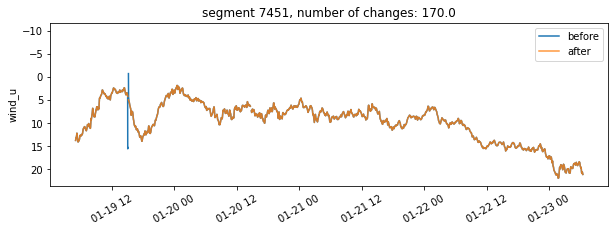

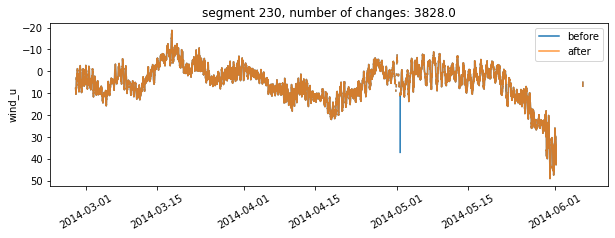

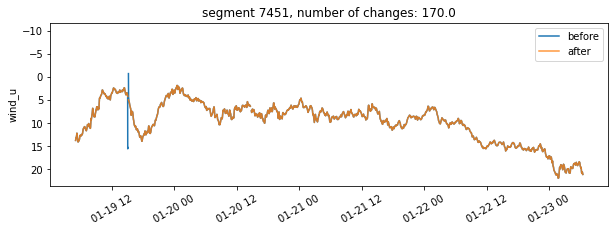

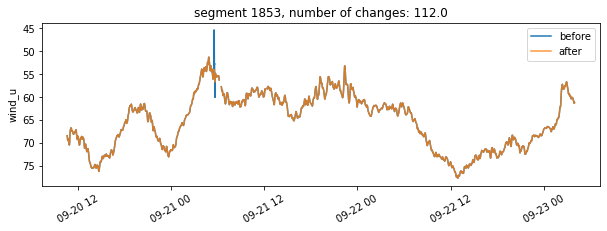

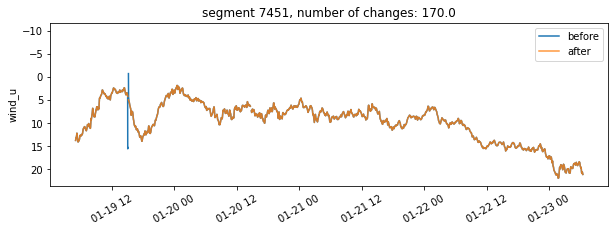

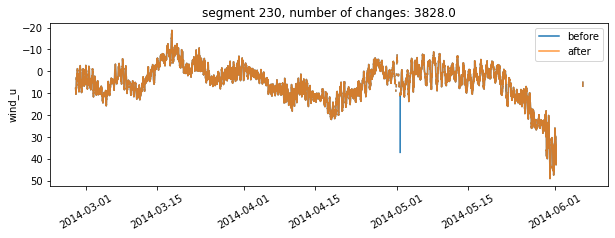

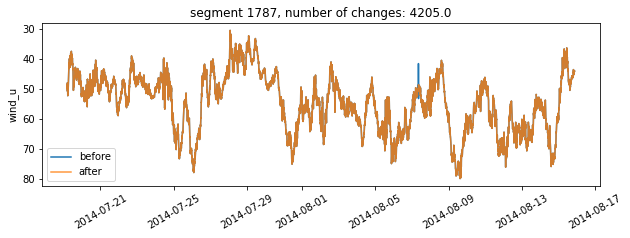

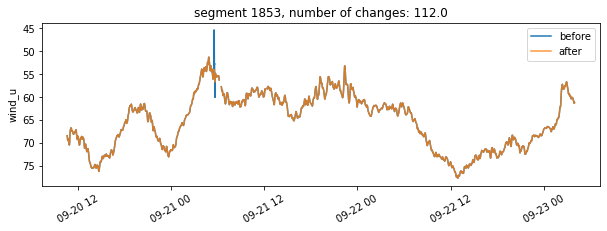

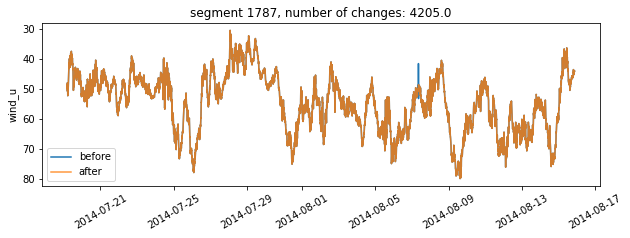

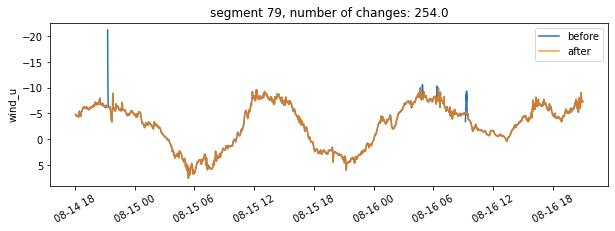

In [5]:
def fix_long_spikes_wind(segment):
    
    if segment.long_spike.sum() != 0: # if the segment has a spike, interpolate across it
        temp = segment.copy()
        temp.loc[temp.long_spike == 1, 'wind_u'] = np.nan
        temp.loc[temp.long_spike == 1, 'wind_v'] = np.nan
        
        # zonal wind
        temp2 = temp.drop(temp.loc[pd.isna(temp.wind_u) == 1].index)
        time_float = np.array(temp2.time).astype('float')
        new_time_float = np.array(segment.time).astype('float')
        f1 = interpolate.PchipInterpolator(time_float, temp2.wind_u)
        wind_u_temp = f1(new_time_float)
        factor = np.array(segment.wind_u)
        segment.wind_u = wind_u_temp*factor/factor # set the values that were NaN originally back to NaN
        
        # meridional wind
        temp2 = temp.drop(temp.loc[pd.isna(temp.wind_v) == 1].index)
        time_float = np.array(temp2.time).astype('float')
        new_time_float = np.array(segment.time).astype('float')
        f1 = interpolate.PchipInterpolator(time_float, temp2.wind_v)
        wind_v_temp = f1(new_time_float)
        factor = np.array(segment.wind_v)
        segment.wind_v = wind_v_temp*factor/factor # set the values that were NaN originally back to NaN
    
    return segment

flights['long_spike'] = 0

# Segment 79 (Flight I-089)
flights.loc[(flights.flight_id == 'I-089') & 
        (flights.time >= np.datetime64('2013-08-14 21:16:42')) &
        (flights.time <= np.datetime64('2013-08-14 21:19:38')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-089') & 
        (flights.time >= np.datetime64('2013-08-16 04:54:38')) &
        (flights.time <= np.datetime64('2013-08-16 04:55:33')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-089') & 
        (flights.time >= np.datetime64('2013-08-16 06:21:39')) &
        (flights.time <= np.datetime64('2013-08-16 06:22:40')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-089') & 
        (flights.time >= np.datetime64('2013-08-16 09:13:37')) &
        (flights.time <= np.datetime64('2013-08-16 09:23:15')), 'long_spike'] = 1

# Segment 230 (Flight I-152)
flights.loc[(flights.flight_id == 'I-152') & 
        (flights.time == np.datetime64('2014-05-01 15:32:20.813000')), 'long_spike'] = 1

# Segment 443 (Flight I-195)
flights.loc[(flights.flight_id == 'I-195') & 
        (flights.time >= np.datetime64('2014-07-02 20:08:19')) &
        (flights.time <= np.datetime64('2014-07-02 20:15:19')), 'long_spike'] = 1

# Segment 1502 (Flight I-249)
flights.loc[(flights.flight_id == 'I-249') & 
        (flights.time >= np.datetime64('2014-07-30 11:57:30')) &
        (flights.time <= np.datetime64('2014-07-30 12:04:30')), 'long_spike'] = 1

# Segment 1787 (Flight I-255)
flights.loc[(flights.flight_id == 'I-255') & 
        (flights.time >= np.datetime64('2014-08-07 08:33:37')) &
        (flights.time <= np.datetime64('2014-08-07 08:40:37')), 'long_spike'] = 1

# Segment 1853 (Flight I-256)
flights.loc[(flights.flight_id == 'I-256') & 
        (flights.time >= np.datetime64('2014-09-21 05:31:44')) &
        (flights.time <= np.datetime64('2014-09-21 05:38:44')), 'long_spike'] = 1

# Segment 5491 (Flight I-343)
flights.loc[(flights.flight_id == 'I-343') & 
        (flights.time >= np.datetime64('2014-08-25 13:40:14.121')) &
        (flights.time <= np.datetime64('2014-08-25 13:42:14.121')), 'long_spike'] = 1

# Segment 7451 (Flight I-444)
flights.loc[(flights.flight_id == 'I-444') & 
        (flights.time >= np.datetime64('2015-01-19 15:05:42.210')) &
        (flights.time <= np.datetime64('2015-01-19 15:15:09.851')), 'long_spike'] = 1

# Segment 21583 (Flight O-252)
flights.loc[(flights.flight_id == 'O-252') & 
        (flights.time >= np.datetime64('2017-05-12 18:36:41')) &
        (flights.time <= np.datetime64('2017-05-12 18:43:42')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'O-252') & 
        (flights.time >= np.datetime64('2017-05-12 21:16:01')) &
        (flights.time <= np.datetime64('2017-05-12 21:31:04')), 'long_spike'] = 1

# Segment 27871 (Flight OL-046)
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time == np.datetime64('2017-05-10 10:41:31')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-11 10:57:16')) &
        (flights.time <= np.datetime64('2017-05-11 11:04:17')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time == np.datetime64('2017-05-12 20:52:11')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-13 21:03:50')) &
        (flights.time <= np.datetime64('2017-05-13 21:10:51')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-14 10:39:27')) &
        (flights.time <= np.datetime64('2017-05-14 10:50:29')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-14 11:03:12')) &
        (flights.time <= np.datetime64('2017-05-14 11:10:14')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-14 20:48:08')) &
        (flights.time <= np.datetime64('2017-05-14 20:54:09')), 'long_spike'] = 1

temp = flights.reset_index(drop=True)
flights = flights.groupby('segment_id').progress_apply(fix_long_spikes_wind).reset_index(drop=True)

before_and_after_segments(temp, flights, 10, 'wind_u', 'wind_u')

### Fix multiple-point altitude spikes, and single spikes missed in the previous step, in segments longer than two days.

This is done by hand; several attempts at writing an algorithm to do this were unsuccessful

Number of segments: 872


/var/folders/dw/3jtpv5j16bv77dfbt2nw04780000gp/T/ipykernel_1330/3182893053.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,3))


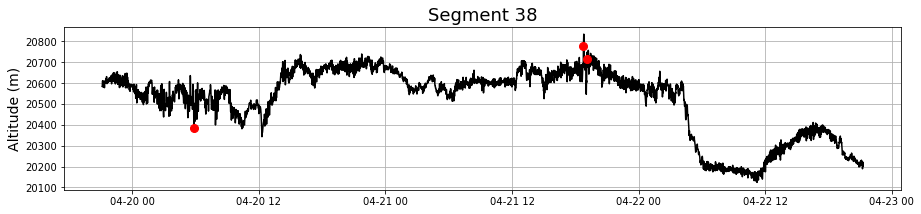

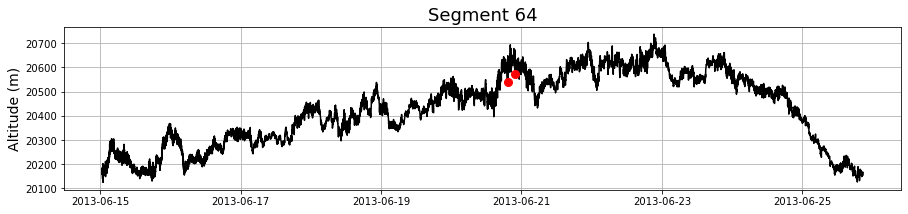

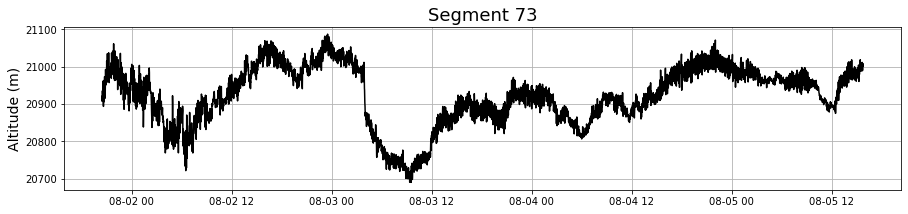

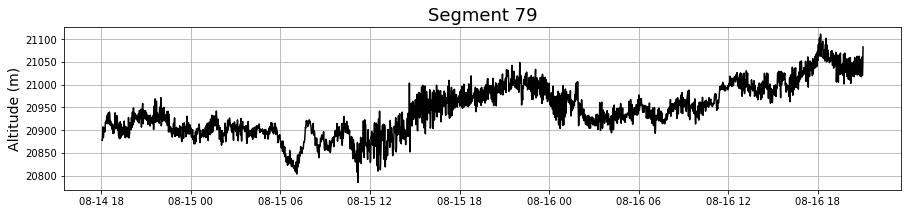

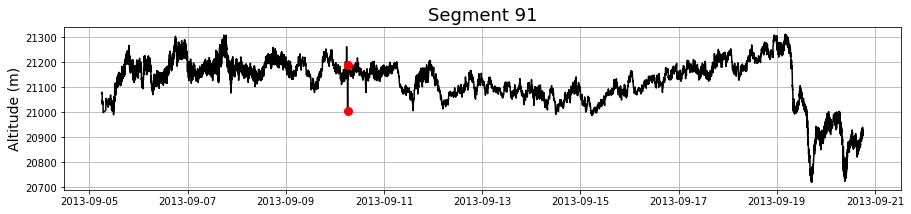

...

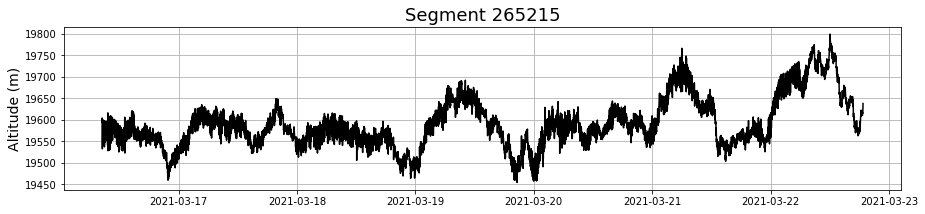

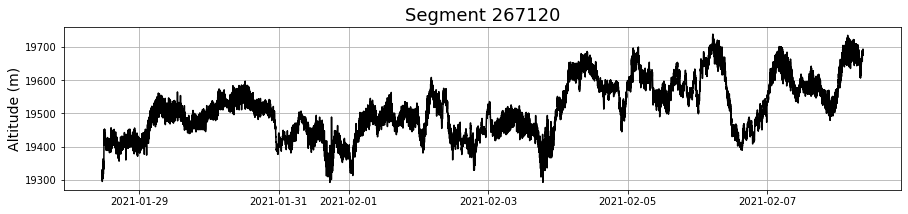

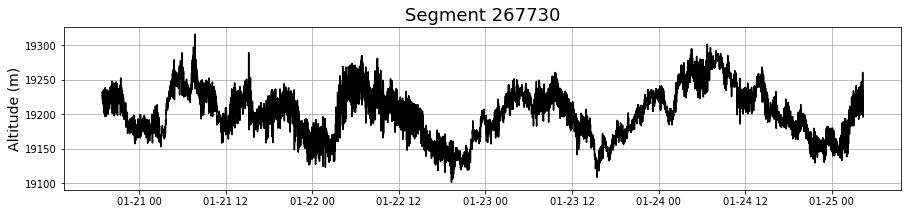

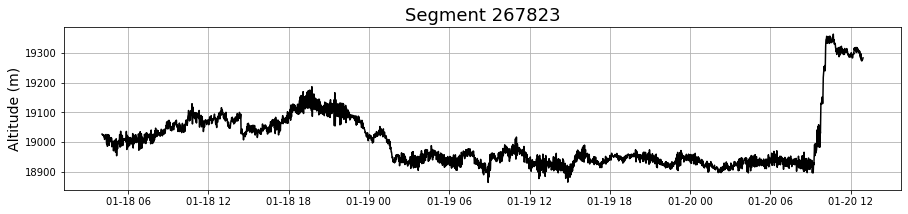

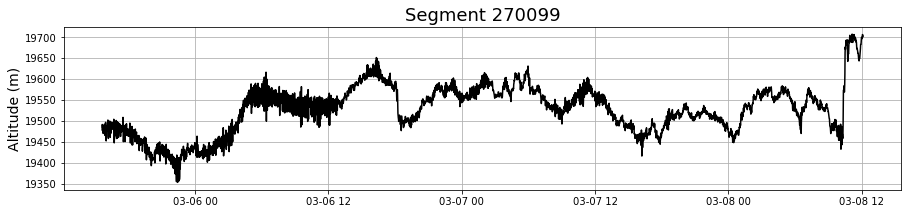

In [18]:
# Find segments longer than two days
min_length = pd.Timedelta('2 days')
segments_to_select = flights.groupby('segment_id').apply(lambda f: f.time.iloc[-1] - f.time.iloc[0])
segments_to_select = segments_to_select[segments_to_select > min_length]
flights_2days = flights[flights.segment_id.isin(segments_to_select.index)]

# Find segments with altitude jumps greater than 100 meters
flights_2days['diff_alt'] = flights_2days.altitude.diff().abs()
diff_segs = flights_2days.groupby('segment_id').apply(lambda f: f.diff_alt.max())
diff_segs = diff_segs[diff_segs > 100]
segment_ids = np.array(diff_segs.index.unique())
n_segments = diff_segs.index.nunique()
print('Number of segments:', n_segments)

# Plot all of these segments, highlighting the altitude jumps
for i in np.arange(n_segments):
    
    segment = flights_2days[flights_2days.segment_id == segment_ids[i]].copy()
    segment['diff_alt'] = segment.altitude.diff().abs()
    temp = segment[segment.diff_alt > 100]
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude,'k')
    plt.plot(temp.time,temp.altitude,'ro',markersize=8)
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14);

### Investigate altitude spikes visually identified above by zooming in on them

If a spike is found, note its location in the dataset

(2013, 42105, 42167)

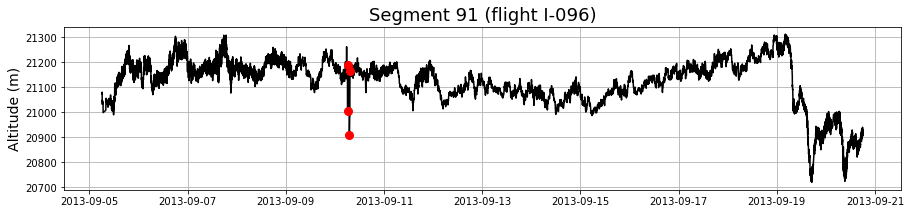

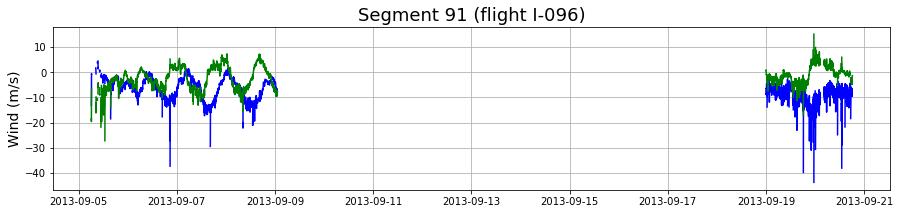

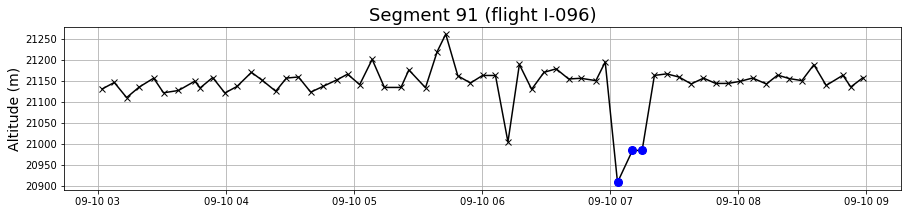

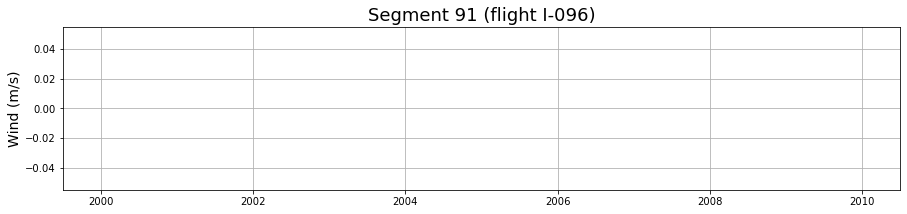

In [10]:
# Lists of segments with possible spikes
definite_spikes = np.array([91,173,402,460,715,1465,1502,1544,1787,1853,1991,2456,5695,5857,7263,7308,7544,
                            9466,9480,9526,21583,27871])
false_alarms = np.array([38,169,236,284,305,701,769,927,941,955,999,1055,1060,1075,1092,1465,1486,
                         2444,2760,2974,3215,3889,5304,5506,5892,5898,6852,9525,9937,21583,67109,
                         102759,168739,186359,192682,265210])

# Look at one segment
segment_id = 91
segment = flights[flights.segment_id == segment_id]
segment['diff_alt'] = segment.altitude.diff().abs()
temp = segment[segment.diff_alt > 100]

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.altitude,'k')
plt.plot(temp.time,temp.altitude,'ro',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

plt.figure(figsize=(15,3))
plt.plot(segment.time,segment.wind_u,'b')
plt.plot(segment.time,segment.wind_v,'g')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Wind (m/s)', fontsize=14);

# Zoom in on the spike, marking its location to be referenced later
time_start = np.datetime64('2013-09-10 03:00')
time_stop =  np.datetime64('2013-09-10 09:00')

plt.figure(figsize=(15,3))
temp = segment[segment.time >= time_start]
temp = temp[temp.time < time_stop]
plt.plot(temp.time,temp.altitude,'-kx')
plt.plot(temp.loc[42147:42149,'time'],temp.loc[42147:42149,'altitude'],'bo',markersize=8)
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Altitude (m)', fontsize=14);

plt.figure(figsize=(15,3))
temp = segment[segment.time >= time_start]
temp = temp[temp.time < time_stop]
plt.plot(temp.time,temp.wind_u,'-bx')
plt.plot(temp.time,temp.wind_v,'-gx')
plt.grid()
plt.title(f'Segment {segment_id} (flight {segment.flight_id.iloc[0]})', fontsize=18)
plt.ylabel('Wind (m/s)', fontsize=14);

segment.time.dt.year.iloc[0], temp.index.min(), temp.index.max()

### Print the flight_ids and times of the altitude spikes, so they can be labeled and removed

By noting the flight_ids and times, fixing the spikes no longer depends on the segment_id or the index, both of which can change.

In [11]:
## DO NOT RE-RUN THIS SECTION OF CODE; THE INDICES MIGHT HAVE CHANGED (SEE COMMENTED OUTPUT BELOW)

# Segment 91 (Flight I-096)
print(flights.loc[42138,['flight_id','time']])
print('')
print(flights.loc[42147:42149,['flight_id','time']])
print('')

# Segment 173 (Flight L-003)
print(flights.loc[313310:313318,['flight_id','time']])
print('')
print(flights.loc[334396:334406,['flight_id','time']])
print('')

# Segment 236 (Flight I-155)
print(flights.loc[504784:504786,['flight_id','time']])
print('')

# Segment 402 (Flight I-190)
print(flights.loc[778910,['flight_id','time']])
print('')

# Segment 460 (Flight I-197)
print(flights.loc[869164,['flight_id','time']])
print('')

# Segment 715 (Flight I-209)
print(flights.loc[1249419:1249422,['flight_id','time']])
print('')

# Segment 1465 (Flight I-245)
print(flights.loc[2514146:2514148,['flight_id','time']])
print('')

# Segment 1502 (Flight I-249)
print(flights.loc[2581999:2582001,['flight_id','time']])
print('')
print(flights.loc[2590676:2590683,['flight_id','time']])
print('')

# Segment 1544 (Flight I-249)
print(flights.loc[2656805:2656810,['flight_id','time']])
print('')

# Segment 1787 (Flight I-255)
print(flights.loc[2978304:2978313,['flight_id','time']])
print('')

# Segment 1853 (Flight I-256)
print(flights.loc[3096336:3096337,['flight_id','time']])
print('')

# Segment 1991 (Flight I-259)
print(flights.loc[3209044:3209045,['flight_id','time']])
print('')
print(flights.loc[3209061,['flight_id','time']])
print('')
print(flights.loc[3209068:3209076,['flight_id','time']])
print('')
print(flights.loc[3209080:3209082,['flight_id','time']])
print('')

# Segment 2456 (Flight I-271)
print(flights.loc[4202099,['flight_id','time']])
print('')

# Segment 5695 (Flight I-355)
print(flights.loc[8722809,['flight_id','time']])
print('')

# Segment 5857 (Flight I-358)
print(flights.loc[8849460:8849461,['flight_id','time']])
print('')
print(flights.loc[8850181:8850184,['flight_id','time']])
print('')
print(flights.loc[8854122:8854123,['flight_id','time']])
print('')

# Segment 7263 (Flight M-040)
print(flights.loc[10064111:10064112,['flight_id','time']])
print('')

# Segment 7308 (Flight M-053)
print(flights.loc[10138201:10138205,['flight_id','time']])
print('')
print(flights.loc[10139018,['flight_id','time']])
print('')

# Segment 7544 (Flight I-450)
print(flights.loc[10288410:10288411,['flight_id','time']])
print('')

# Segment 9466 (Flight NG-390)
print(flights.loc[10996751,['flight_id','time']])
print('')

# Segment 9526 (Flight NR-215)
print(flights.loc[11013041,['flight_id','time']])
print('')

# Segment 21583 (Flight O-252)
print(flights.loc[14087491,['flight_id','time']])
print('')

# Segment 27871 (Flight OL-046)
print(flights.loc[15610305:15610306,['flight_id','time']])
print('')
print(flights.loc[15613061:15613062,['flight_id','time']])
print('')

## OUTPUT FROM THE ABOVE SECTION OF CODE:
#flight_id                  I-096
#time         2013-09-10 06:12:06
#Name: 42138, dtype: object
#
#      flight_id                time
#42147     I-096 2013-09-10 07:03:26
#42148     I-096 2013-09-10 07:10:26
#42149     I-096 2013-09-10 07:14:58
#
#       flight_id                time
#313310     L-003 2014-01-23 08:09:13
#313311     L-003 2014-01-23 08:09:39
#313312     L-003 2014-01-23 08:10:49
#313313     L-003 2014-01-23 08:11:43
#313314     L-003 2014-01-23 08:17:22
#313315     L-003 2014-01-23 08:17:59
#313316     L-003 2014-01-23 08:18:08
#313317     L-003 2014-01-23 08:19:26
#313318     L-003 2014-01-23 08:19:40
#
#       flight_id                time
#334396     L-003 2014-02-12 15:58:55
#334397     L-003 2014-02-12 16:04:53
#334398     L-003 2014-02-12 16:25:10
#334399     L-003 2014-02-12 16:34:57
#334400     L-003 2014-02-12 16:56:56
#334401     L-003 2014-02-12 17:04:54
#334402     L-003 2014-02-12 17:25:08
#334403     L-003 2014-02-12 17:34:54
#334404     L-003 2014-02-12 17:57:15
#334405     L-003 2014-02-12 18:04:53
#334406     L-003 2014-02-12 18:24:52
#
#       flight_id                    time
#504784     I-155 2014-03-19 15:58:54.210
#504785     I-155 2014-03-19 15:59:54.210
#504786     I-155 2014-03-19 16:00:54.210
#
#flight_id                  I-197
#time         2014-06-15 14:37:21
#Name: 869164, dtype: object
#
#
#flight_id                  I-190
#time         2014-05-12 18:30:03
#Name: 778910, dtype: object
#
#        flight_id                time
#1249419     I-209 2014-06-24 03:38:52
#1249420     I-209 2014-06-24 03:39:52
#1249421     I-209 2014-06-24 03:40:52
#1249422     I-209 2014-06-24 03:41:52
#
#        flight_id                time
#2514146     I-245 2014-11-08 01:39:31
#2514147     I-245 2014-11-08 01:42:31
#2514148     I-245 2014-11-08 01:45:31
#
#        flight_id                time
#2581999     I-249 2014-07-27 07:08:33
#2582000     I-249 2014-07-27 07:09:33
#2582001     I-249 2014-07-27 07:10:33
#
#        flight_id                time
#2590676     I-249 2014-08-02 07:56:55
#2590677     I-249 2014-08-02 07:57:55
#2590678     I-249 2014-08-02 07:58:55
#2590679     I-249 2014-08-02 07:59:55
#2590680     I-249 2014-08-02 08:00:55
#2590681     I-249 2014-08-02 08:01:55
#2590682     I-249 2014-08-02 08:03:55
#2590683     I-249 2014-08-02 08:04:55
#
#        flight_id                time
#2656805     I-249 2014-09-20 02:47:01
#2656806     I-249 2014-09-20 02:48:01
#2656807     I-249 2014-09-20 02:49:01
#2656808     I-249 2014-09-20 02:50:01
#2656809     I-249 2014-09-20 02:51:01
#2656810     I-249 2014-09-20 02:52:01
#
#        flight_id                time
#2978304     I-255 2014-08-12 21:54:10
#2978305     I-255 2014-08-12 21:55:10
#2978306     I-255 2014-08-12 21:56:10
#2978307     I-255 2014-08-12 21:58:10
#2978308     I-255 2014-08-12 21:59:10
#2978309     I-255 2014-08-12 22:00:10
#2978310     I-255 2014-08-12 22:01:10
#2978311     I-255 2014-08-12 22:02:10
#2978312     I-255 2014-08-12 22:03:10
#2978313     I-255 2014-08-12 22:04:10
#
#        flight_id                time
#3096336     I-256 2014-09-20 16:18:43
#3096337     I-256 2014-09-20 16:19:43
#
#
#        flight_id                time
#3209044     I-259 2014-08-21 21:27:52
#3209045     I-259 2014-08-21 21:28:52
#
#flight_id                  I-259
#time         2014-08-21 21:44:52
#Name: 3209061, dtype: object
#
#        flight_id                time
#3209068     I-259 2014-08-21 21:51:52
#3209069     I-259 2014-08-21 21:52:52
#3209070     I-259 2014-08-21 21:53:52
#3209071     I-259 2014-08-21 21:54:52
#3209072     I-259 2014-08-21 21:55:52
#3209073     I-259 2014-08-21 21:56:52
#3209074     I-259 2014-08-21 21:57:52
#3209075     I-259 2014-08-21 21:58:52
#3209076     I-259 2014-08-21 21:59:52
#
#        flight_id                time
#3209080     I-259 2014-08-21 22:03:52
#3209081     I-259 2014-08-21 22:04:52
#3209082     I-259 2014-08-21 22:05:52
#
#flight_id                  I-271
#time         2014-07-18 09:32:56
#Name: 4202099, dtype: object
#
#flight_id                         I-355
#time         2014-11-26 16:56:20.238000
#Name: 8722809, dtype: object
#
#        flight_id                    time
#8849460     I-358 2014-08-28 18:52:17.023
#8849461     I-358 2014-08-28 18:53:18.023
#
#        flight_id                    time
#8850181     I-358 2014-08-29 07:14:18.070
#8850182     I-358 2014-08-29 07:15:18.070
#8850183     I-358 2014-08-29 07:16:18.070
#8850184     I-358 2014-08-29 07:17:18.070
#
#        flight_id                    time
#8854122     I-358 2014-09-01 02:59:21.269
#8854123     I-358 2014-09-01 03:00:21.269
#
#         flight_id                    time
#10064111     M-040 2014-10-18 02:52:46.650
#10064112     M-040 2014-10-18 02:55:46.650
#
#         flight_id                    time
#10138201     M-053 2014-12-22 09:31:40.210
#10138202     M-053 2014-12-22 09:32:41.210
#10138203     M-053 2014-12-22 09:33:41.210
#10138204     M-053 2014-12-22 09:34:41.210
#10138205     M-053 2014-12-22 09:35:41.210
#
#flight_id                         M-053
#time         2014-12-22 23:16:45.843000
#Name: 10139018, dtype: object
#
#         flight_id                    time
#10288410     I-450 2015-02-05 18:22:17.757
#10288411     I-450 2015-02-05 18:23:17.757
#
#flight_id                 NG-390
#time         2016-07-27 08:19:03
#Name: 10996751, dtype: object
#
#flight_id                 NR-215
#time         2016-02-09 08:56:35
#Name: 11013041, dtype: object
#
#flight_id                  O-252
#time         2017-05-12 18:39:42
#Name: 14087491, dtype: object
#
#         flight_id                time
#15610305    OL-046 2017-05-11 20:05:28
#15610306    OL-046 2017-05-11 20:06:28
#
#         flight_id                time
#15613061    OL-046 2017-05-13 20:29:41
#15613062    OL-046 2017-05-13 20:30:42

flight_id                  I-096
time         2013-09-10 06:12:06
Name: 42138, dtype: object

      flight_id                time
42147     I-096 2013-09-10 07:03:26
42148     I-096 2013-09-10 07:10:26
42149     I-096 2013-09-10 07:14:58

       flight_id                time
313310     L-003 2014-01-23 08:09:13
313311     L-003 2014-01-23 08:09:39
313312     L-003 2014-01-23 08:10:49
313313     L-003 2014-01-23 08:11:43
313314     L-003 2014-01-23 08:17:22
313315     L-003 2014-01-23 08:17:59
313316     L-003 2014-01-23 08:18:08
313317     L-003 2014-01-23 08:19:26
313318     L-003 2014-01-23 08:19:40

       flight_id                time
334396     L-003 2014-02-12 15:58:55
334397     L-003 2014-02-12 16:04:53
334398     L-003 2014-02-12 16:25:10
334399     L-003 2014-02-12 16:34:57
334400     L-003 2014-02-12 16:56:56
334401     L-003 2014-02-12 17:04:54
334402     L-003 2014-02-12 17:25:08
334403     L-003 2014-02-12 17:34:54
334404     L-003 2014-02-12 17:57:15
334405     L-003 201

  0%|          | 0/124073 [00:00<?, ?it/s]

/Users/briangre/Documents/gravity_waves/loon/zenodo_data_processing_prod/devl/notebook_utils.py:12: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  diff_segs = diff_segs.groupby('segment_id').apply(lambda f: f.sum(axis=0)).drop(columns=['segment_id'])


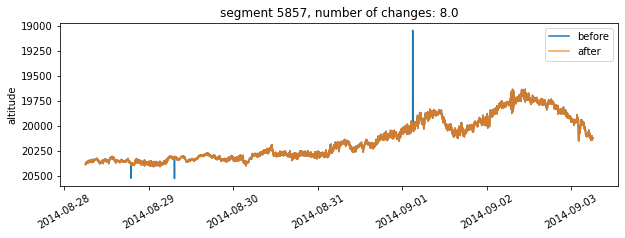

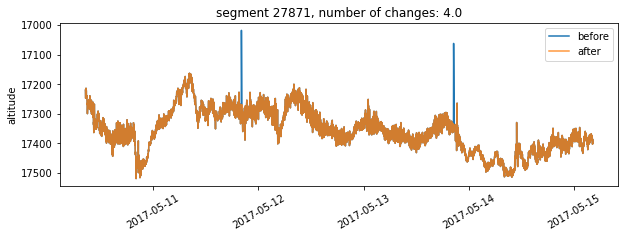

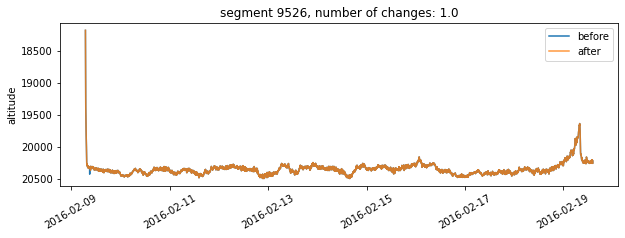

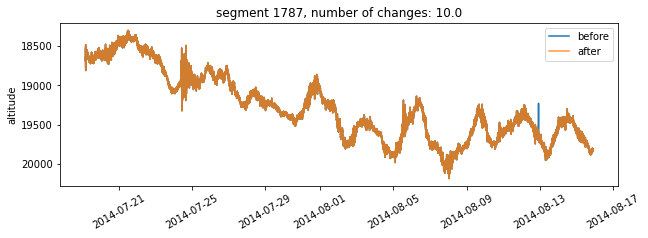

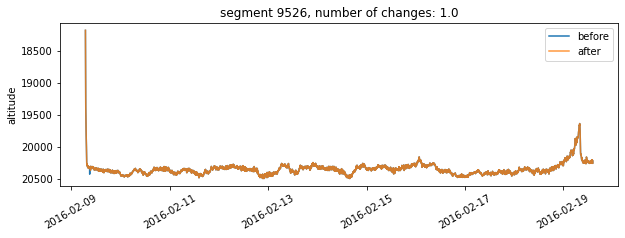

...

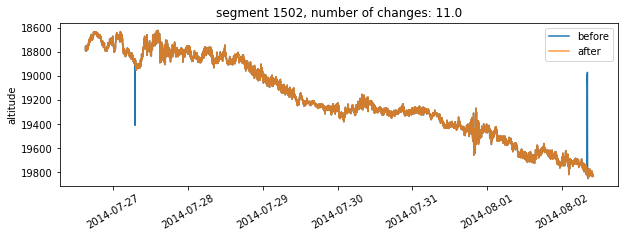

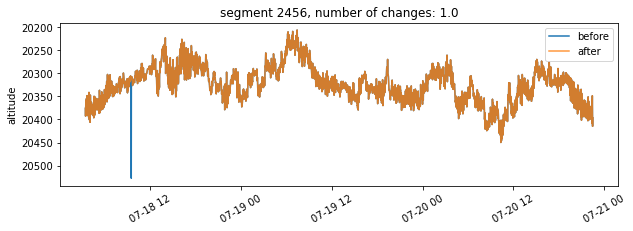

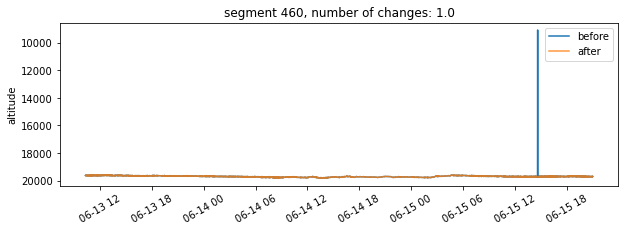

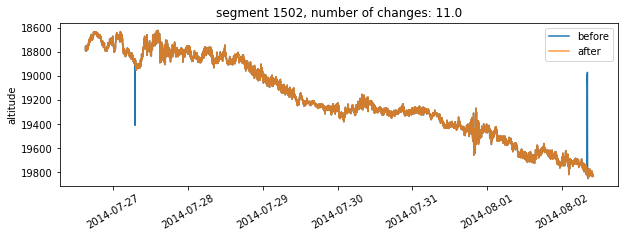

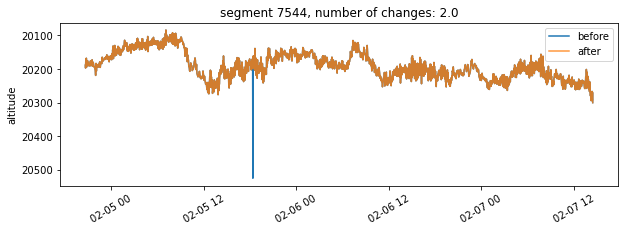

In [12]:
def fix_long_spikes_alt(segment):
    
    if segment.long_spike.sum() != 0: # if the segment has a spike, interpolate across it
        temp = segment.copy()
        temp.loc[temp.long_spike == 1, 'altitude'] = np.nan
        temp = temp.drop(temp.loc[pd.isna(temp.altitude) == 1].index)
        time_float = np.array(temp.time).astype('float')
        new_time_float = np.array(segment.time).astype('float')
        f1 = interpolate.PchipInterpolator(time_float, temp.altitude)
        altitude_temp = f1(new_time_float)
        factor = np.array(segment.altitude)
        segment.altitude = altitude_temp*factor/factor # set the values that were NaN originally back to NaN
    
    return segment

flights['long_spike'] = 0

# Segment 91 (Flight I-096)
flights.loc[(flights.flight_id == 'I-096') & 
        (flights.time == np.datetime64('2013-09-10 06:12:06')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-096') & 
        (flights.time >= np.datetime64('2013-09-10 07:03:26')) &
        (flights.time <= np.datetime64('2013-09-10 07:14:58')), 'long_spike'] = 1

# Segment 173 (Flight L-003)
flights.loc[(flights.flight_id == 'L-003') & 
        (flights.time >= np.datetime64('2014-01-23 08:09:13')) &
        (flights.time <= np.datetime64('2014-01-23 08:19:40')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'L-003') & 
        (flights.time >= np.datetime64('2014-02-12 15:58:55')) &
        (flights.time <= np.datetime64('2014-02-12 18:24:52')), 'long_spike'] = 1

# Segment 236 (Flight I-155)
flights.loc[(flights.flight_id == 'I-155') & 
        (flights.time >= np.datetime64('2014-03-19 15:58:54.210')) &
        (flights.time <= np.datetime64('2014-03-19 16:00:54.210')), 'long_spike'] = 1

# Segment 402 (Flight I-190)
flights.loc[(flights.flight_id == 'I-190') & 
        (flights.time == np.datetime64('2014-05-12 18:30:03')), 'long_spike'] = 1

# Segment 460 (Flight I-197)
flights.loc[(flights.flight_id == 'I-197') & 
        (flights.time == np.datetime64('2014-06-15 14:37:21')), 'long_spike'] = 1

# Segment 715 (Flight I-209)
flights.loc[(flights.flight_id == 'I-209') & 
        (flights.time >= np.datetime64('2014-06-24 03:38:52')) &
        (flights.time <= np.datetime64('2014-06-24 03:41:52')), 'long_spike'] = 1

# Segment 1465 (Flight I-245)
flights.loc[(flights.flight_id == 'I-245') & 
        (flights.time >= np.datetime64('2014-11-08 01:39:31')) &
        (flights.time <= np.datetime64('2014-11-08 01:39:31')), 'long_spike'] = 1

# Segment 1502 (Flight I-249)
flights.loc[(flights.flight_id == 'I-249') & 
        (flights.time >= np.datetime64('2014-07-27 07:08:33')) &
        (flights.time <= np.datetime64('2014-07-27 07:10:33')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-249') & 
        (flights.time >= np.datetime64('2014-08-02 07:56:55')) &
        (flights.time <= np.datetime64('2014-08-02 08:04:55')), 'long_spike'] = 1

# Segment 1544 (Flight I-249)
flights.loc[(flights.flight_id == 'I-249') & 
        (flights.time >= np.datetime64('2014-09-20 02:47:01')) &
        (flights.time <= np.datetime64('2014-09-20 02:52:01')), 'long_spike'] = 1

# Segment 1787 (Flight I-255)
flights.loc[(flights.flight_id == 'I-255') & 
        (flights.time >= np.datetime64('2014-08-12 21:54:10')) &
        (flights.time <= np.datetime64('2014-08-12 22:04:10')), 'long_spike'] = 1

# Segment 1853 (Flight I-256)
flights.loc[(flights.flight_id == 'I-256') & 
        (flights.time >= np.datetime64('2014-09-20 16:18:43')) &
        (flights.time <= np.datetime64('2014-09-20 16:19:43')), 'long_spike'] = 1

# Segment 1991 (Flight I-259)
flights.loc[(flights.flight_id == 'I-259') & 
        (flights.time >= np.datetime64('2014-08-21 21:27:52')) &
        (flights.time <= np.datetime64('2014-08-21 21:28:52')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-259') & 
        (flights.time == np.datetime64('2014-08-21 21:44:52')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-259') & 
        (flights.time >= np.datetime64('2014-08-21 21:51:52')) &
        (flights.time <= np.datetime64('2014-08-21 21:59:52')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-259') & 
        (flights.time >= np.datetime64('2014-08-21 22:03:52')) &
        (flights.time <= np.datetime64('2014-08-21 22:05:52')), 'long_spike'] = 1

# Segment 2456 (Flight I-271)
flights.loc[(flights.flight_id == 'I-271') & 
        (flights.time == np.datetime64('2014-07-18 09:32:56')), 'long_spike'] = 1

# Segment 5695 (Flight I-355)
flights.loc[(flights.flight_id == 'I-355') & 
        (flights.time == np.datetime64('2014-11-26 16:56:20.238000')), 'long_spike'] = 1

# Segment 5857 (Flight I-358)
flights.loc[(flights.flight_id == 'I-358') & 
        (flights.time >= np.datetime64('2014-08-28 18:52:17.023')) &
        (flights.time <= np.datetime64('2014-08-28 18:53:18.023')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-358') & 
        (flights.time >= np.datetime64('2014-08-29 07:14:18.070')) &
        (flights.time <= np.datetime64('2014-08-29 07:17:18.070')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'I-358') & 
        (flights.time >= np.datetime64('2014-09-01 02:59:21.269')) &
        (flights.time <= np.datetime64('2014-09-01 03:00:21.269')), 'long_spike'] = 1

# Segment 7263 (Flight M-040)
flights.loc[(flights.flight_id == 'M-040') & 
        (flights.time >= np.datetime64('2014-10-18 02:52:46.650')) &
        (flights.time <= np.datetime64('2014-10-18 02:55:46.650')), 'long_spike'] = 1

# Segment 7308 (Flight M-053)
flights.loc[(flights.flight_id == 'M-053') & 
        (flights.time >= np.datetime64('2014-12-22 09:31:40.210')) &
        (flights.time <= np.datetime64('2014-12-22 09:35:41.210')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'M-053') & 
        (flights.time == np.datetime64('2014-12-22 23:16:45.843000')), 'long_spike'] = 1

# Segment 7544 (Flight I-450)
flights.loc[(flights.flight_id == 'I-450') & 
        (flights.time >= np.datetime64('2015-02-05 18:22:17.757')) &
        (flights.time <= np.datetime64('2015-02-05 18:23:17.757')), 'long_spike'] = 1

# Segment 9466 (Flight NG-390)
flights.loc[(flights.flight_id == 'NG-390') & 
        (flights.time == np.datetime64('2016-07-27 08:19:03')), 'long_spike'] = 1

# Segment 9526 (Flight NR-215)
flights.loc[(flights.flight_id == 'NR-215') & 
        (flights.time == np.datetime64('2016-02-09 08:56:35')), 'long_spike'] = 1

# Segment 21583 (Flight O-252)
flights.loc[(flights.flight_id == 'O-252') & 
        (flights.time == np.datetime64('2017-05-12 18:39:42')), 'long_spike'] = 1

# Segment 27871 (Flight OL-046)
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-11 20:05:28')) &
        (flights.time <= np.datetime64('2017-05-11 20:06:28')), 'long_spike'] = 1
flights.loc[(flights.flight_id == 'OL-046') & 
        (flights.time >= np.datetime64('2017-05-13 20:29:41')) &
        (flights.time <= np.datetime64('2017-05-13 20:30:42')), 'long_spike'] = 1

temp = flights.reset_index(drop=True)
flights = flights.groupby('segment_id').progress_apply(fix_long_spikes_alt).reset_index(drop=True)

before_and_after_segments(temp, flights, 13, 'altitude', 'altitude')

In [14]:
flights.to_feather('4_flights_nativetime_intermediate_multispikes.feather')

In [12]:
flights = pd.read_feather('4_flights_nativetime_intermediate_multispikes.feather')

### Mark the data where altitude spikes have been detected and removed

Number of segments with changes: 633


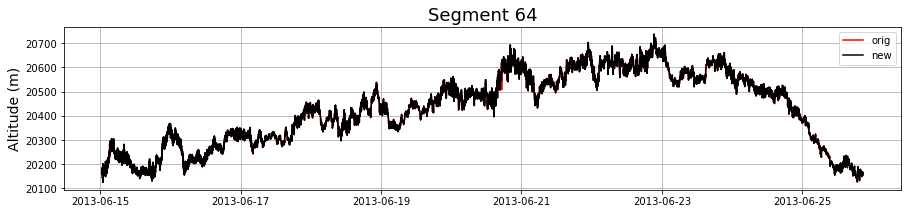

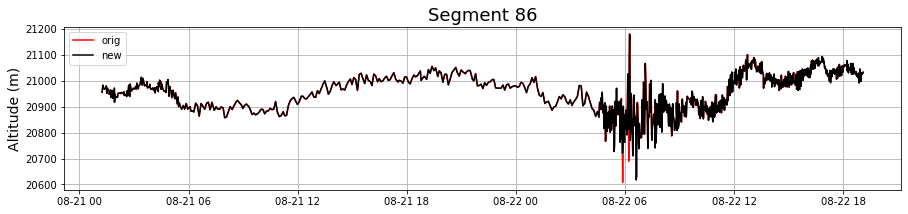

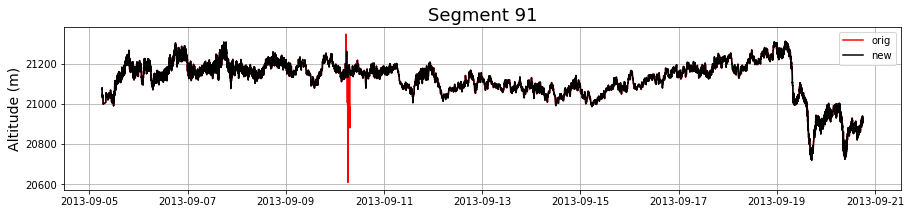

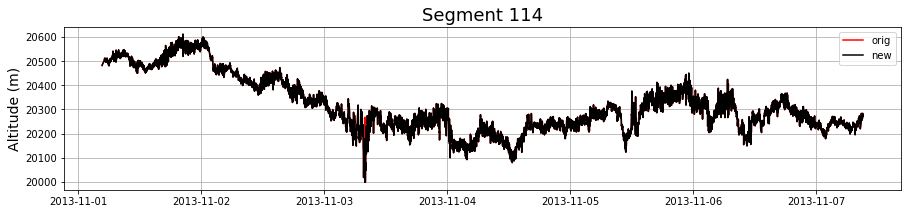

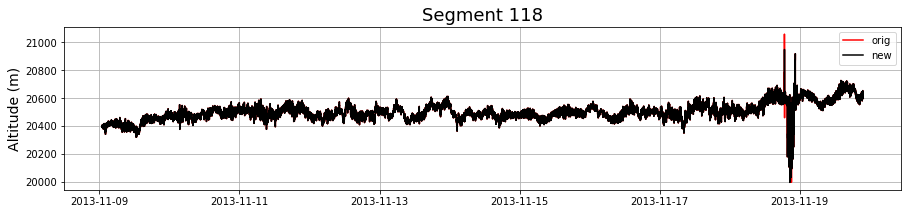

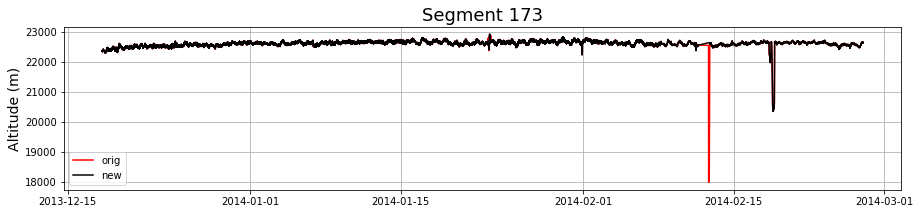

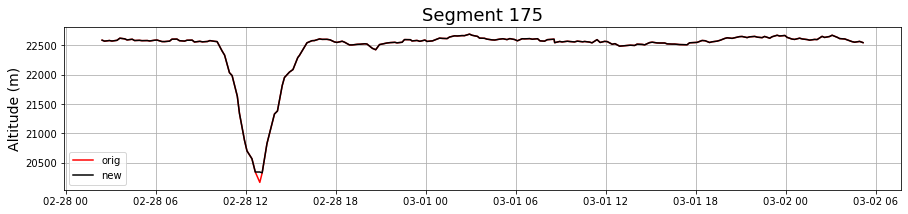

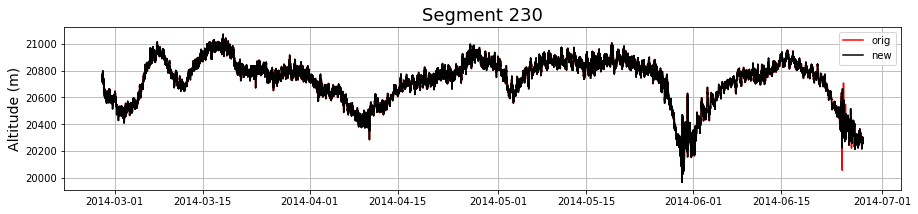

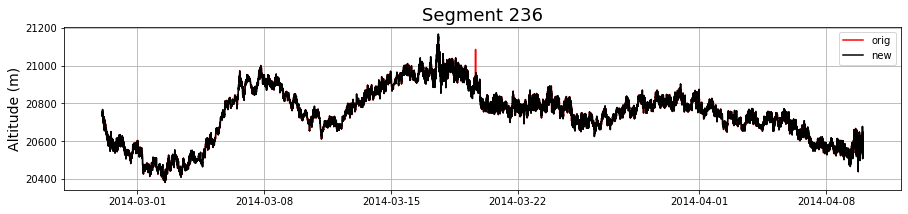

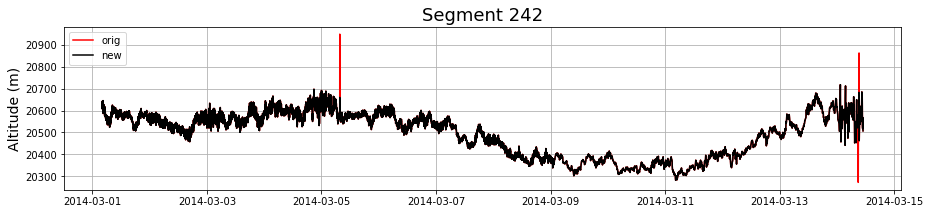

In [15]:
# Load in the original altitude data
flights_old = pd.read_feather('../temp_data/3b_segments_cosmic.feather')
flights_old = flights_old.rename(columns={'velocity_u': 'wind_u'})
flights_old = flights_old.rename(columns={'velocity_v': 'wind_v'})

# drop time steps with NaN altitude data
flights_old = flights_old.drop(flights_old.loc[pd.isna(flights_old.altitude) == 1].index)
flights_old = flights_old.reset_index(drop=True)

# If the altitude data has changed, flag it
flights['altitude_orig'] = flights_old.altitude.copy()
del flights_old
flights['altitude_spike'] = 0
flights.loc[flights.altitude - flights.altitude_orig != 0, 'altitude_spike'] = 1

# Plot some segments
temp = flights[flights.altitude_spike == 1]
segment_ids = temp.segment_id.unique()
n_segments = temp.segment_id.nunique()
print('Number of segments with changes:', n_segments)
#for i in np.arange(n_segments):
for i in np.arange(10):
    
    segment = flights[flights.segment_id == segment_ids[i]].copy()
    
    plt.figure(figsize=(15,3))
    plt.plot(segment.time,segment.altitude_orig,'r')
    plt.plot(segment.time,segment.altitude,'k')
    plt.grid()
    plt.title(f'Segment {segment_ids[i]}', fontsize=18)
    plt.ylabel('Altitude (m)', fontsize=14)
    plt.legend(['orig','new']);

### Delete unnecesssary columns and save the data to disk

In [16]:
flights = flights.drop(columns = ['dt','long_spike','altitude_orig']).reset_index(drop=True)
flights.to_feather('4_flights_nativetime.feather')
flights